<a href="https://colab.research.google.com/github/thually/MazeAlgorithms/blob/main/MazeAlgorithms_esp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Maze Algorithms**

---

## Alejandro Salazar Mejía

---

### 🧀‍ꡌ‍ꡙ‍ꡚ‍🐁

[https://github.com/thually](https://github.com/thually)

In [1]:
from abc import ABC, abstractmethod

class Maze(ABC):
    import networkx as nx
    def __init__(self, rows: int, cols: int, seed: int = None):
        self.rows = rows
        self.cols = cols
        self.seed = seed

    @abstractmethod
    def plot(self, show=True) -> None:
        """Grafica el laberinto.
        Método abstracto que debe ser implementado por las clases hijas"""
        pass

    @abstractmethod
    def generate_maze(self) -> nx.Graph:
        """Genera el laberinto.
        Método abstracto que debe ser implementado por las clases hijas"""
        pass

In [2]:
class MazeCell:
    """ Representa una celda del laberinto.
    Para identificar una celda en el laberinto, se utiliza un par de coordenadas (x,y)."""

    def __init__(self, x: int, y: int, id: int = None):
        self.x = x
        self.y = y
        self.xy = (x,y)

        # Para la estructura Disjoint Set necesaria en Kruskal necesitamos:
        self.parent = self
        self.rank = 0 # Cota superior de la altura de su árbol

        # Para la animación de Kruskal:
        self.id = id

        # Para  Dead-end filling Algorithm
        self.visited = False
        self.color = 'white'

    def get_parent_id(self):
        return self.parent.id

    def __repr__(self) -> str:
        return f"Cell({self.x}, {self.y})"

class MazeWall:
    """ Representa una pared del laberinto.
    Para identificar una pared en el laberinto, se utiliza el par de celdas que separa."""

    def __init__(self, cell1: MazeCell, cell2: MazeCell):
        self.cell1 = cell1
        self.cell2 = cell2
        # Dedemos tener una variable booleana que nos diga si la pared está o no en el laberinto
        self.in_maze = True

        # Para la animación:
        self.color = 'black'

    def __repr__(self) -> str:
        return f"Wall[ ({self.cell1.x},{self.cell1.y}) - ({self.cell2.x},{self.cell2.y}) {self.in_maze} ]"

## **MAZE GENERATION**: Iterative randomized Kruskal's algorithm (with sets)

### Kruskal's algorithm

El algoritmo de Kruskal es un algoritmo voraz utilizado para encontrar un bosque recubridor mínimo en un grafo ponderado. Si el grafo es conexo, busca un subconjunto de aristas que, formando un árbol, incluyen todos los vértices y donde el valor de la suma de todas las aristas del árbol es el mínimo. Si el grafo no es conexo, entonces busca un bosque recubridor mínimo (un árbol recubridor mínimo para cada componente conexa).  
EL algoritmo comienza con un grafo vacío y agrega iterativamente la arista más corta que no crea un ciclo hasta que todos los vértices estén conectados.

Estos son los pasos del algoritmo de Kruskal:

1. Ordena todas las aristas del grafo en orden no decreciente de sus pesos.
2. Inicializa un grafo vacío para almacenar el bosque de expansión mínimo.
3. Itera a través de las aristas ordenadas y agrega cada arista al bosque de expansión mínimo si no crea un ciclo.
   - Para verificar si la adición de una arista crea un ciclo, podemos usar la estructura de datos de conjuntos disjuntos.
4. Continúa agregando aristas hasta que todos los vértices estén conectados o no queden más aristas.

El grafo resultante será un bosque de expansión mínimo, que es un bosque que conecta todos los vértices con el peso total mínimo.

El algoritmo de Kruskal es eficiente y tiene una complejidad de tiempo de $O(E log E)$, donde E es el número de aristas en el grafo.

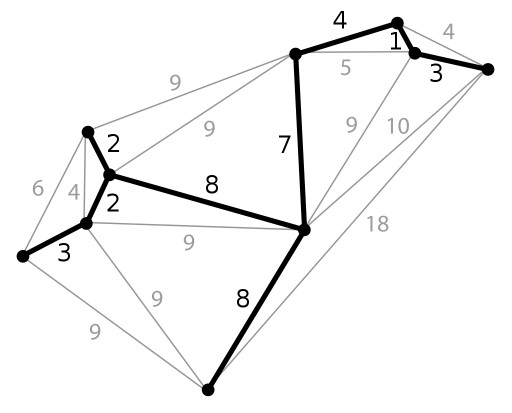

Un grafo plano y su árbol recubridor mínimo. Cada arista se etiqueta con su peso.

<p><a href="https://commons.wikimedia.org/wiki/File:KruskalDemo.gif#/media/File:KruskalDemo.gif"><img src="https://upload.wikimedia.org/wikipedia/commons/b/bb/KruskalDemo.gif" alt="KruskalDemo.gif" height="323" width="314"></a>

Animación del algoritmo de Kruskal en un grafo completo con pesos basados en la distancia euclídea

<br>By <a href="https://commons.wikimedia.org/wiki/User:Shiyu_Ji" title="User:Shiyu Ji">Shiyu Ji</a> - <span class="int-own-work" lang="en">Own work</span>, <a href="https://creativecommons.org/licenses/by-sa/4.0" title="Creative Commons Attribution-Share Alike 4.0">CC BY-SA 4.0</a>, <a href="https://commons.wikimedia.org/w/index.php?curid=54420893">Link</a></p>

### Kruskal's Maze generation algorithm

El algoritmo de Kruskal puede ser utilizado para generar laberintos de una manera bastante interesante. Aquí está la teoría detrás de este proceso:

1. Crea una lista de todas las paredes, y crea un conjunto para cada celda, cada uno conteniendo sólo esa celda.
2. Para cada pared, en orden aleatorio:
   - Si las celdas divididas por esta pared pertenecen a conjuntos diferentes:
      - Elimina la pared entre las celdas.
      - Une los conjuntos de las celdas divididas por la pared.

Existen varias estructuras de datos que pueden utilizarse para modelar los conjuntos de celdas. Una implementación eficiente que utilice una estructura de datos de conjuntos disjuntos puede realizar cada operación de unión y búsqueda en dos conjuntos en un tiempo amortizado casi constante.

### Disjoint-set data structure

Una estructura de datos de conjuntos disjuntos es una estructura de datos que almacena una colección de conjuntos disjuntos (no solapados). Equivalentemente, almacena una partición de un conjunto en subconjuntos disjuntos. Esta estructura permite añadir nuevos conjuntos, fusionar conjuntos (sustituyéndolos por su unión) y encontrar un miembro representativo de un conjunto. Esta última operación permite averiguar eficientemente si dos elementos cualesquiera se encuentran en conjuntos iguales o diferentes.

Para nuestra aplicación, utilizamos una implementación denominada **bosque de conjuntos disjuntos** (disjoint-set forest). Se trata de un tipo especializado de bosque que realiza uniones y búsquedas en un tiempo amortizado casi constante. Los bosques de conjuntos disjuntos no garantizan este rendimiento por operación. Las operaciones individuales de unión y búsqueda pueden tardar más que un tiempo constante, pero cada operación hace que el bosque de conjuntos disjuntos se ajuste para que las operaciones sucesivas sean más rápidas.


#### Representación
Cada nodo de un bosque de conjuntos disjuntos consiste en un objeto `MazeCell`, que tiene un puntero y cierta información auxiliar llamada rango (*rank*). Los punteros se utilizan para crear Árboles de Puntero a Padre (*Parent pointer tree*), en los que cada nodo que no es la raíz de un árbol apunta a su padre. Cada árbol representa uno de los conjuntos disjuntos almacenados en el bosque y cuyos elementos son los nodos del árbol. Los nodos raíz son los representantes del conjunto: **Dos nodos están en el mismo conjunto si y sólo si las raíces de los árboles que contienen a los nodos son iguales.**

#### Operaciones

- **Making new sets:**  
Al crear un nuevo objeto `MazeCell`, se crea un nuevo conjunto disjunto que representa una sola celda del laberinto. El puntero al padre apunta a sí mismo y el rango se inicializa en 0.

- **Union by rank:**
Para la unión por rango, un nodo almacena su rango, que es una cota superior para su altura. Cuando se inicializa un nodo, su rango se establece en cero. Para combinar árboles con raíces `x` e `y`, primero se comparan sus rangos. Si los rangos son diferentes, el árbol de mayor rango se convierte en el padre, y los rangos de `x` e `y` no cambian. Si los rangos son iguales, cualquiera de los dos puede convertirse en padre, pero el rango del nuevo padre se incrementa en uno.

| 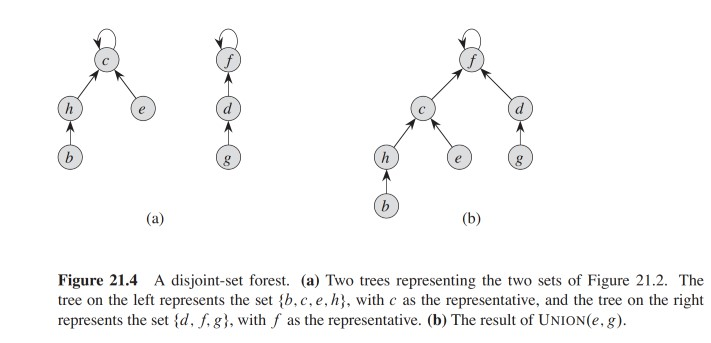 |
|:--:|
| Imagen tomada de <em>Introduction to Algorithms, Third Edition</em> - CLRS|

- **Finding the representative of a set:**  
Para encontrar el representante de un conjunto, se sigue la cadena de punteros al padre (*parent pointers*) desde el nodo hasta la raíz del árbol. La raíz es el representante del conjunto. Realizar una operación de búsqueda presenta una oportunidad para mejorar el bosque: los punteros a padres visitados durante esta búsqueda pueden actualizarse para que apunten más cerca de la raíz. Dado que cada elemento visitado en el camino hacia una raíz forma parte del mismo conjunto, esto no cambia los conjuntos almacenados en el bosque.  
En esta aplicación el algoritmo de búsqueda que se utilizó pertenece a una familia de algoritmos de búsqueda denominados **compresión de ruta** (*path compression*). La idea es hacer que cada nodo visitado durante la búsqueda apunte directamente a la raíz del árbol.  
La compresión de rutas se puede implementar utilizando una simple recursión de la siguiente manera:  

```python
def find_set(x):
    if x.parent != x:
        x.parent = find_set(x.parent)
    return x.parent
```

| 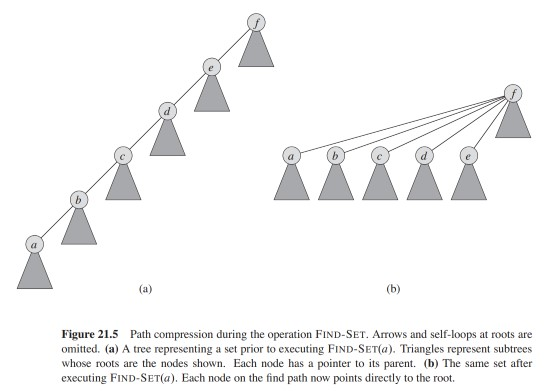 |
|:--:|
| Imagen tomada de <em>Introduction to Algorithms, Third Edition</em> - CLRS|

In [3]:
class KruskalMaze(Maze):
    """ Clase que encapsula los métodos necesarios para generar un laberinto utilizando el algoritmo de Kruskal """
    import networkx as nx

    def __init__(self, rows: int, cols: int, seed: int = None):
        super().__init__(rows, cols, seed)
        self.cells:list[list[MazeCell]] = [ [] for _ in range(rows) ]
        self.walls: list[MazeWall]      = []

        # Inicializamos las celdas y las paredes
        id = 0
        for i in range(rows):
            for j in range(cols):
                self.cells[i].append(MazeCell(i, j, id))
                if i > 0:
                    self.walls.append(MazeWall(self.cells[i-1][j], self.cells[i][j]))
                if j > 0:
                    self.walls.append(MazeWall(self.cells[i][j-1], self.cells[i][j]))
                id += 1

    def find(self, cell: MazeCell) -> MazeCell:
        """ Encuentra el representante del conjunto al que pertenece la celda
        utilizando un algorithm de path compression """
        if cell.parent != cell:
            cell.parent = self.find(cell.parent)
        return cell.parent

    def union(self, cell1: MazeCell, cell2: MazeCell) -> bool:
        """ Une los conjuntos de celdas de cell1 y cell2 utilizando union by rank.
         Devuelve True si se han unido y False si ya estaban unidos """
        root1 = self.find(cell1)
        root2 = self.find(cell2)
        if root1 == root2:
            return True # Ya estaban unidos
        if root1.rank > root2.rank:
            root2.parent = root1
        elif root1.rank < root2.rank:
            root1.parent = root2
        else:
            root2.parent = root1
            root1.rank += 1
        return False # Se han unido

    def generate_maze(self, show_graph=True) -> nx.Graph:
        """ Genera el laberinto utilizando el algoritmo de Kruskal.
        Devuelve un grafo de networkx que representa el laberinto"""
        import random
        import networkx as nx
        import matplotlib.pyplot as plt
        random.seed(self.seed)  # Para que el laberinto sea reproducible
        walls = random.sample(self.walls, len(self.walls))
        for wall in walls:
            """ Si las celdas divididas por esta pared pertenecen a conjuntos distintos
                entonces la pared se elimina del laberinto """
            wall.in_maze = self.union(wall.cell1, wall.cell2)

        # Creamos un grafo de networkx para representar el laberinto
        # Cada celda es un nodo y existe una arista entre dos nodos si son vecinos y no hay una pared entre ellos
        edge_list = [ (wall.cell1, wall.cell2) for wall in self.walls if not wall.in_maze ]
        graph = nx.Graph(edge_list)
        if show_graph:
            pos = { cell: (cell.y+0.5, cell.x+0.5) for cell in graph.nodes }
            self.plot(show=False)
            nx.draw(graph, pos=pos, node_size=5, edge_color='blue')
            plt.title(f'Representación del laberinto en forma de grafo')
            plt.show()
        return graph

    def plot_pared(self, wall: MazeWall):
        """ Dibuja una pared utilizando matplotlib """
        import matplotlib.pyplot as plt
        if wall.in_maze:
            """ OJO: Para graficar una linea entre dos puntos (x1, y1) y (x2, y2)
            utilizamos plt.plot([x1, x2], [y1, y2], color='black') """
            if wall.cell1.x == wall.cell2.x:
                #  Pared vertical
                i = wall.cell2.x
                j = wall.cell2.y
                plt.plot([j, j], [i, i+1], color=wall.color)
            elif wall.cell1.y == wall.cell2.y:
                # Pared horizontal
                i = wall.cell2.x
                j = wall.cell2.y
                plt.plot([j, j+1], [i, i], color=wall.color)

    def plot_contorno(self):
        """ Dibuja el contorno del laberinto utilizando matplotlib """
        import matplotlib.pyplot as plt
        """ OJO: Para graficar una linea entre dos puntos (x1, y1) y (x2, y2)
        utilizamos plt.plot([x1, x2], [y1, y2], color='black') """
        plt.plot([0, self.cols], [0, 0], color='black')
        plt.plot([0, self.cols], [self.rows, self.rows], color='black')
        plt.plot([0, 0], [0, self.rows], color='black')
        plt.plot([self.cols, self.cols], [0, self.rows], color='black')

    def plot(self, show=True) -> None:
        """ Dibuja el laberinto utilizando matplotlib """
        import matplotlib.pyplot as plt
        fig, ax = plt.subplots()
        plt.axis('equal')
        # Tamaño de la figura
        plt.gcf().set_size_inches(7, 7)
        # Graficamos el contorno del laberinto
        self.plot_contorno()

        plt.axis('off')

        for wall in self.walls:
            if wall.in_maze:
                self.plot_pared(wall)

        if show: plt.show()

        return fig, ax


    def animate(self):
        """ Genera una animación del algoritmo de Kruskal.
        Para más detalles sobre qué significa cada paso en la animación, revisar el notebook
        más abajo en la sección de ejemplos."""

        import matplotlib.pyplot as plt
        from matplotlib.animation import FuncAnimation
        from IPython.display import HTML

        # Your function to generate plots (replace this with your plotting code)
        def generate_plot(wall: tuple[int, MazeWall]):
            """Para más detalles sobre qué significa cada paso en la animación, revisar el notebook
            más abajo en la sección de ejemplos."""


            ax.set_aspect('equal')
            ax.axis('off')
            self.plot_contorno()

            step = wall[0]
            curr_wall = wall[1]
            if curr_wall is not None:
                curr_cell1 = curr_wall.cell1
                curr_cell2 = curr_wall.cell2

            if step == 0:

                plot_paredes()
                plot_celdas()

            elif step == 1:
                curr_wall.color = 'red'

                ax.add_patch(plt.Rectangle((curr_cell1.y, curr_cell1.x), 1, 1, color='red', alpha=0.3))
                ax.add_patch(plt.Rectangle((curr_cell2.y, curr_cell2.x), 1, 1, color='red', alpha=0.3))

                plot_paredes()
                plot_celdas()

            elif step == 2:
                curr_wall.color = 'blue'

                parent1 = self.find(curr_cell1)
                ax.add_patch(plt.Rectangle((parent1.y, parent1.x), 1, 1, color='green', alpha=0.3))
                ax.add_patch(plt.Rectangle((curr_cell1.y, curr_cell1.x), 1, 1, color='blue', alpha=0.3))

                parent2 = self.find(curr_cell2)
                ax.add_patch(plt.Rectangle((parent2.y, parent2.x), 1, 1, color='green', alpha=0.3))
                ax.add_patch(plt.Rectangle((curr_cell2.y, curr_cell2.x), 1, 1, color='blue', alpha=0.3))

                plot_paredes()
                plot_celdas()

            elif step == 3:
                curr_wall.color = 'black'

                curr_wall.in_maze = self.union(curr_cell1, curr_cell2)

                plot_paredes()
                plot_celdas()

            elif step == -1:
                plot_paredes()

        def plot_paredes():
            for wall in self.walls:
                self.plot_pared(wall)


        def plot_celdas():
            """Por cada celda en el laberinto vamos a imprimir el id de su padre
            en la posición de la celda"""

            x = max(self.rows, self.cols)
            font_size = 26 - (13*x)/10 + x**2/50

            for i in range(self.rows):
                for j in range(self.cols):
                    cell = self.cells[i][j]
                    plt.text(j + 0.5, i + 0.5, cell.get_parent_id(), ha='center', va='center', color="black", fontsize=font_size)

        # Create a figure and axis
        fig, ax = plt.subplots()
        # Tamaño de la figura
        fig.set_size_inches(7, 7)

        # Function to update the plot for each frame
        def update(wall: tuple[int, MazeWall]):
            ax.clear()
            generate_plot(wall)

        import random
        import matplotlib as mpl
        random.seed(self.seed)
        walls = random.sample(self.walls, len(self.walls))
        # Por cada pared tenemos 4 frames en la animación:
        frames = [(0, None)] + [ (i, wall) for wall in walls for i in range(1, 3+1) ] + [(-1, None)]



        # Set the embed limit to a larger value (in MB)
        mpl.rcParams['animation.embed_limit'] = 50

        # Create the animation
        ani = FuncAnimation(fig, update, frames=frames, interval=500)
        ani_jshtml = ani.to_jshtml()
        plt.close()

        # Display the animation in the notebook
        return HTML(ani_jshtml)




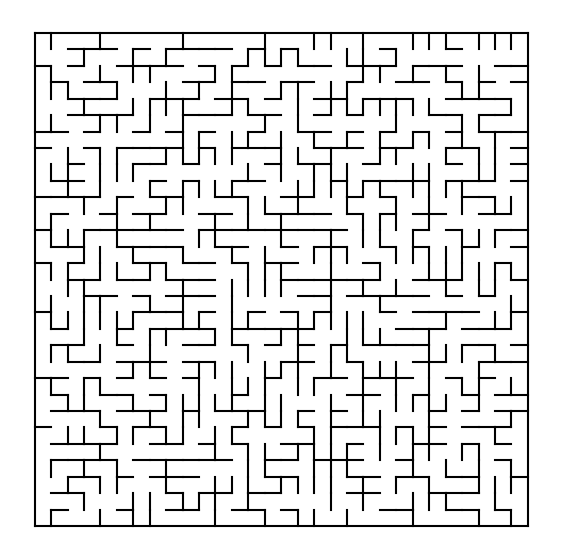

(<Figure size 700x700 with 1 Axes>, <Axes: >)

In [4]:
mymaze = KruskalMaze(30, 30)
mymaze.generate_maze(show_graph=False)
mymaze.plot()

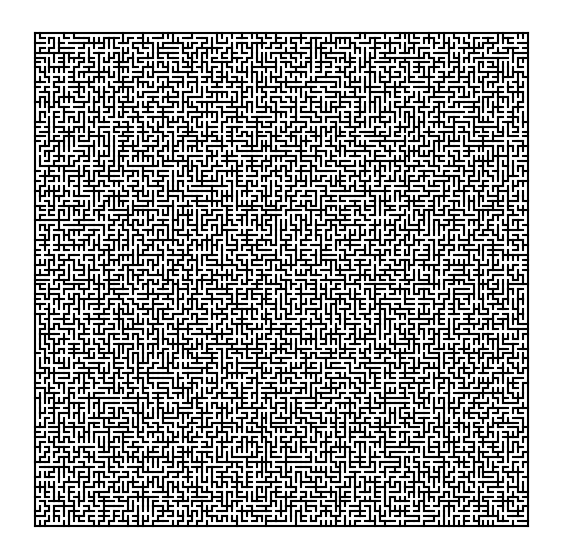

(<Figure size 700x700 with 1 Axes>, <Axes: >)

In [5]:
mymaze = KruskalMaze(100, 100)
mymaze.generate_maze(show_graph=False)
mymaze.plot()

### Animation

La animación muestra el proceso de generación de un laberinto utilizando el algoritmo de Kruskal.  
Cada celda del laberinto contiene el `id` de su padre en el bosque de conjuntos disjuntos. Al comienzo del algoritmo, cada celda se encuentra en un conjunto diferente y por tanto cada celda tiene como padre a sí misma.  
En cada iteración:
1. Se selecciona una pared aleatoria. Se pinta de <font color="red">rojo</font> esta pared y las celdas que divide.
2. Se hace búsqueda del representante en ambas celdas. Esto posiblemente actualiza el `id` del padre de las celdas en cuestión y de otras celdas en el laberinto gracias al *path compression*. Se escribe el nuevo `id` del padre de cada celda. Las dos celdas en cuestión se pintan de <font color="blue">azul</font> y sus respectivos padres de <font color="green">verde</font>.
3. Si los representantes (padres) son iguales, se deja la pared. Si los representantes son diferentes, se elimina la pared y se unen los conjuntos. Al unir los conjuntos, el padre de la celda con menor rango pasa a ser hijo del padre de la celda con mayor rango, y por tanto su `id` del padre se actualiza en el laberinto. Se despintan las celdas y la pared.

In [6]:
maze = KruskalMaze(5, 5, seed=0)
maze.animate()

## **MAZE SOLVING**: Dead-End Filling Algorithm

El relleno de callejones sin salida es un algoritmo para resolver laberintos que rellena todos los callejones sin salida, dejando sólo los caminos correctos sin rellenar. Se puede utilizar para resolver laberintos sobre papel o con un programa de computador, pero no es útil para una persona dentro de un laberinto desconocido, ya que este método examina todo el laberinto de golpe.  

El procedimiento es el siguiente:
1. Encontrar todos los callejones sin salida en el laberinto, y luego
2. "rellenar" el camino desde cada callejón sin salida hasta llegar al primer cruce.

Note que algunos callejones no se rellenarán hasta que no se rellenen primero otros callejones sin salida.  

Todo callejón sin salida tiene un comienzo y un camino que lo conecta con el camino correcto, pues el laberinto es un árbol. Sin embargo, el camino correcto no se rellena (la única forma de poderlo rellenar es si se pintara la celda inicial o final), así que el callejón sin salida se para de rellenar cuando se encuentra con el camino correcto. Además, el algoritmo no para hasta que todos los callejones sin salida se hayan rellenado. Un camino que no lleva a la celda final eventualmente se convierte en un callejón sin salida, y por tanto se rellena. Así, el algoritmo siempre termina y encuentra el camino correcto.

In [7]:
class DeadEndFillingSolver:
    """ Clase que encapsula los métodos necesarios para resolver un laberinto utilizando el algoritmo de Dead-end filling """

    def __init__(self, maze: Maze):
        self.maze = maze
        self.maze_graph = maze.generate_maze()

    def is_start_or_end(self, node: MazeCell) -> bool:
        """ Devuelve True si el nodo es el nodo de inicio o el nodo de meta """
        return node.xy == (0,0) or node.xy == (self.maze.rows-1, self.maze.cols-1)

    def solve_and_animate_v1(self):
        import matplotlib.pyplot as plt
        from matplotlib.animation import FuncAnimation
        from IPython.display import HTML
        import matplotlib as mpl

        # Create a figure and axis
        fig, ax = self.maze.plot(show=False)
        # Tamaño de la figura
        fig.set_size_inches(7, 7)

        def update(frame: list[MazeCell]):
            for celda in frame:
                    ax.add_patch(plt.Rectangle((celda.y, celda.x), 1, 1, color=celda.color, alpha=0.3))


        def gen_function() -> list[MazeCell]:
            """ Generador que devuelve el siguiente paso de la solución.
            Vamos a asumir que la posición inicial es la esquina inferior izquierda
            y la meta es la esquina superior derecha """

            maze_graph = self.maze_graph.copy()

            yield []

            deadends = []
            # El primer paso es encontrar los 'dead-ends' del laberinto
            # Si un nodo X del grafo diferente del nodo de inicio y del nodo de meta
            # tiene solo un vecino, entonces X es un 'dead-end'.
            for node in maze_graph.nodes:
                if not self.is_start_or_end(node):
                    if maze_graph.degree(node) == 1:
                        node.color = 'red'
                        node.visited = True
                        deadends.append(node)
                        yield [node]

            # El segundo paso es rellenar el camino desde los deadends hasta que se se tope con el primer cruce
            # Para esto, vamos a considerar los vecinos de los deadends como candidatos a ser rellenados
            candidates_deadends = set()
            for node in deadends:
                neighbor_node = list(maze_graph.neighbors(node))[0]
                candidates_deadends.add(neighbor_node)
                maze_graph.remove_edge(node, neighbor_node) # Borramos la arista entre el deadend y su vecino

            while len(deadends) > 0:

                deadends = [] # Los agregamos a esta lista serán rellenados
                for node in candidates_deadends:
                    # Evaluamos si nos encontramos con un cruce, y si no lo es, lo agregamos a la lista de deadends
                    if maze_graph.degree(node) == 1 and not self.is_start_or_end(node):
                        node.color = 'blue'
                        deadends.append(node)

                yield deadends # Se rellenan las celdas en deadends

                candidates_deadends = set() # Los agregamos a esta lista serán candidatos a ser rellenados
                for node in deadends:
                    neighbor_node = list(maze_graph.neighbors(node))[0] # deadend solo tiene un vecino
                    candidates_deadends.add(neighbor_node)
                    # Borramos la arista entre el deadend y su vecino
                    maze_graph.remove_edge(node, neighbor_node)


        # Set the embed limit to a larger value (in MB)
        mpl.rcParams['animation.embed_limit'] = 50

        # Create the animation
        ani = FuncAnimation(fig, update, frames=gen_function, interval=200, cache_frame_data=False)
        ani_jshtml = ani.to_jshtml()
        plt.close()

        # Display the animation in the notebook
        return HTML(ani_jshtml)

    def solve_and_animate_v2(self):
        import matplotlib.pyplot as plt
        from matplotlib.animation import FuncAnimation
        from IPython.display import HTML
        import matplotlib as mpl

        # Create a figure and axis
        fig, ax = self.maze.plot(show=False)
        # Tamaño de la figura
        fig.set_size_inches(7, 7)

        def update(celda: MazeCell):
            ax.add_patch(plt.Rectangle((celda.y, celda.x), 1, 1, color=celda.color, alpha=0.3))


        def gen_function() -> MazeCell:
            """ Generador que devuelve el siguiente paso de la solución.
            Vamos a asumir que la posición inicial es la esquina inferior izquierda
            y la meta es la esquina superior derecha """

            yield MazeCell(0,0)

            maze_graph = self.maze_graph.copy()

            for node in maze_graph.nodes:
                if not self.is_start_or_end(node):
                    if maze_graph.degree(node) == 1:
                        node.color = 'red'
                        yield node

                        neighbor_node = list(maze_graph.neighbors(node))[0]
                        maze_graph.remove_edge(node, neighbor_node)
                        node = neighbor_node
                        while maze_graph.degree(node) == 1 and not self.is_start_or_end(node):
                            node.color = 'blue'
                            yield node
                            neighbor_node = list(maze_graph.neighbors(node))[0]
                            maze_graph.remove_edge(node, neighbor_node)
                            node = neighbor_node


        # Set the embed limit to a larger value (in MB)
        mpl.rcParams['animation.embed_limit'] = 50

        # Create the animation
        ani = FuncAnimation(fig, update, frames=gen_function, interval=200, cache_frame_data=False)
        ani_jshtml = ani.to_jshtml()
        plt.close()

        # Display the animation in the notebook
        return HTML(ani_jshtml)


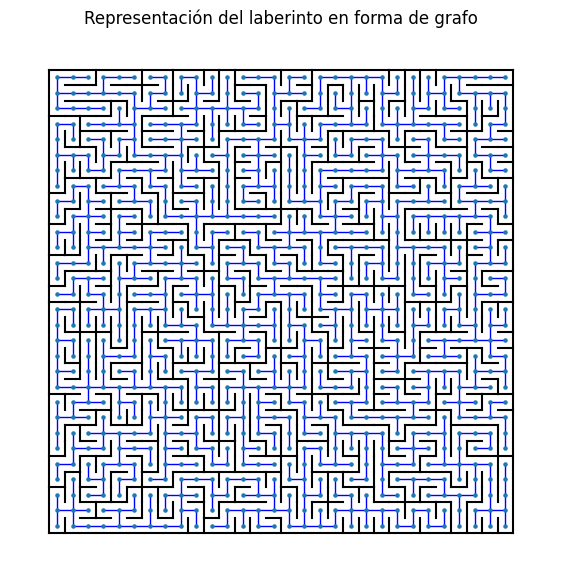

In [8]:
my_maze = KruskalMaze(30, 30)
my_solver = DeadEndFillingSolver(my_maze)

### Animation - v1

La primera animación ilustra la primera implementación del algoritmo que se podría plantear.  
Primero se buscan todos los callejones sin salida del laberinto y luego se van rellenando todos al mismo tiempo hasta que se encuentren con un cruce.

In [9]:
my_solver.solve_and_animate_v1()

### Animation - v2

La segunda animación ilustra una segunda implementación del algoritmo.  
Primero se busca un callejón sin salida y se rellena hasta que se encuentre con un cruce. Luego se busca otro callejón sin salida y se rellena hasta que se encuentre con un cruce. Y así sucesivamente hasta que no queden más callejones sin salida.

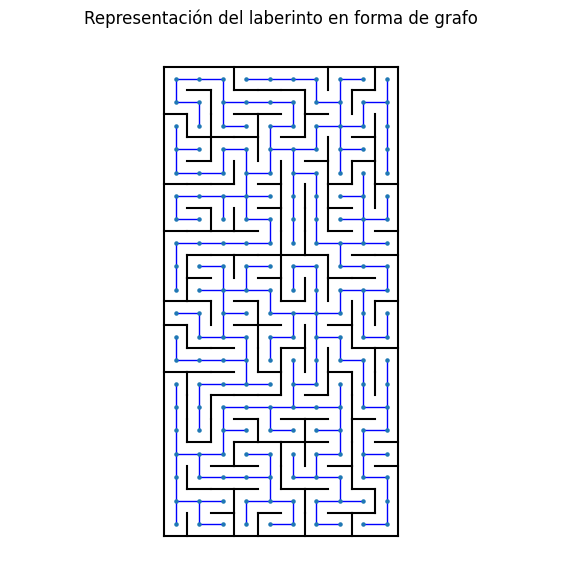

In [10]:
my_maze = KruskalMaze(20, 10)
my_solver = DeadEndFillingSolver(my_maze)
my_solver.solve_and_animate_v2()